### 1. Correlation Matrixes among all countries and extra socioeconomic variables 
### 2. Top 3 stronger pairs among countries in correlation

In [1]:
import os 
import pandas as pd
import geopandas as gpd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

city='cph'
years = [1990,1992, 1994, 1996, 1998, 2000, 2002, 2004, 2006, 2008, 2010, 2012, 2014, 2016, 2018] #1990,1992, 1994, 1996, 1998, 2000, 2002, 2004, 2006, 2008, 2010, 2012, 2014, 2016, 2018
cor_path= "K:/FUME/popnet/PoPNetV2/data_scripts/cph_Projectdata/correlations"
ancillary_POPdata_folder_path = "K:/FUME/popnet/PoPNetV2/data_scripts/{}_Projectdata/PopData".format(city)

#### Calculate correlation matrix for all countries, ages, education etc and save it to csv file 
#### Plot matrix and save it as picture 

In [14]:
def calc_cor(ancillary_POPdata_folder_path, year):
    # Load point data
    js = gpd.read_file(ancillary_POPdata_folder_path + '/{}/temp_shp/L10_PopCOO.shp'.format(year))
    js= js.iloc[:, :-3]
    #print(js)
    dataframe_list=[js]
    # Now get the rest of the sociodemographic data
    for file in os.listdir(ancillary_POPdata_folder_path + '/{}/temp_shp'.format(year)):
        # L2-L6 : 5 age groups
        # L11 : Births, L12 : Deaths
        # L13a : Marriages,male 
        # L18 : High Education
        # L19 : Share Rich , L20 : Share Poor
        indicators = ['L2','L3','L4','L5','L6','L11','L12','L13a', 'L18','L19','L20' ]
        for i in indicators:
            if file.endswith('.shp') and file.startswith('{0}_'.format(i)) and not file.endswith('NEWINCOME.shp'):
                #print(file)
                ks = gpd.read_file(ancillary_POPdata_folder_path + '/{0}/temp_shp/{1}'.format(year, file))
                ks = ks.iloc[:,0: 2]
                dataframe_list.append(ks)
    
    df_merged = pd.concat(dataframe_list)
    print(df_merged.columns)             
    #cor = df_merged.corr(method='pearson')
    correlation_mat = df_merged.corr(method='pearson')
    kot = correlation_mat[correlation_mat>=.3]
    plt.figure(figsize=(100,100))
    sns.heatmap(kot, cmap="twilight")

    plt.title("Correlation matrix of Migrants by Country of origin, {}".format(year),fontsize=100)
    plt.xlabel("Country of Origin", fontsize=60)
    plt.ylabel("Country of Origin", fontsize=60)
    #plt.xticks(fontsize=20, rotation=0)
    plt.yticks(fontsize=40, rotation=0)
    plt.savefig(cor_path + "/{}_corMatrix.png".format(year), dpi=300)
    plt.show()  
    #correlation_mat.to_csv(cor_path + "/{}_cor.csv".format(year))

In [16]:
#for year in years:
year= 2018
calc_cor(ancillary_POPdata_folder_path, year)

Index(['GC100m', 'AFG', 'AGO', 'ALB', 'AND', 'ARE', 'ARG', 'ARM', 'ATG', 'AUS',
       ...
       'SUM_Deaths', 'SUM_Marria', 'P_TEDUC', 'P_RICH', 'P_POOR', 'P00_19',
       'P20_29', 'P30_44', 'P45_64', 'P65'],
      dtype='object', length=223)


Get Matrixes for countries with population > 1000

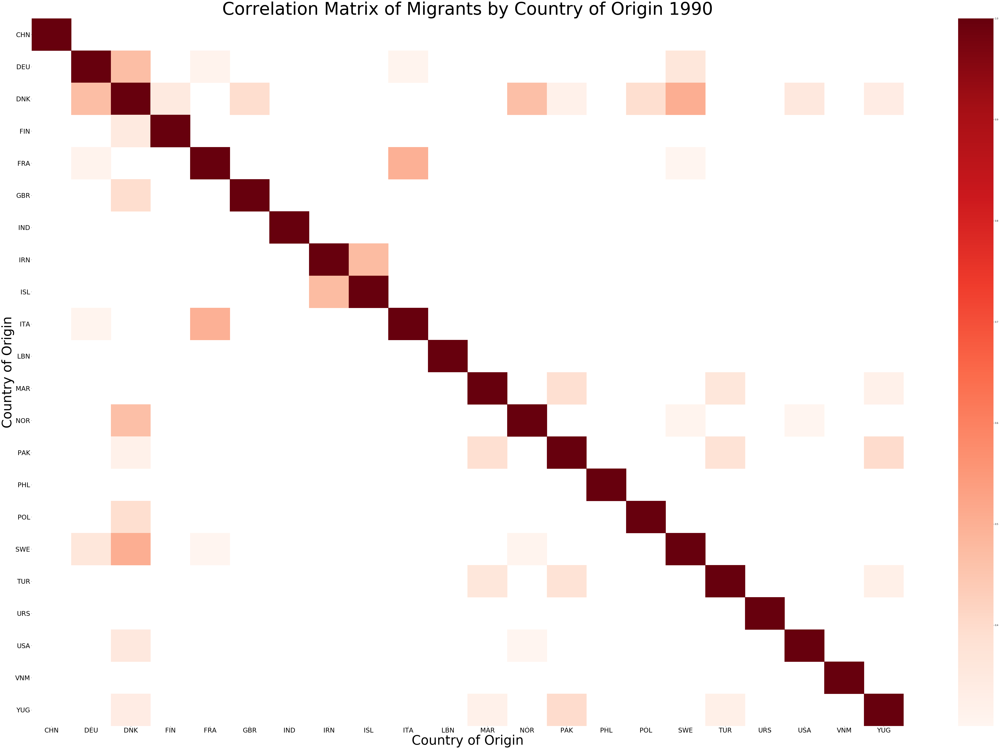

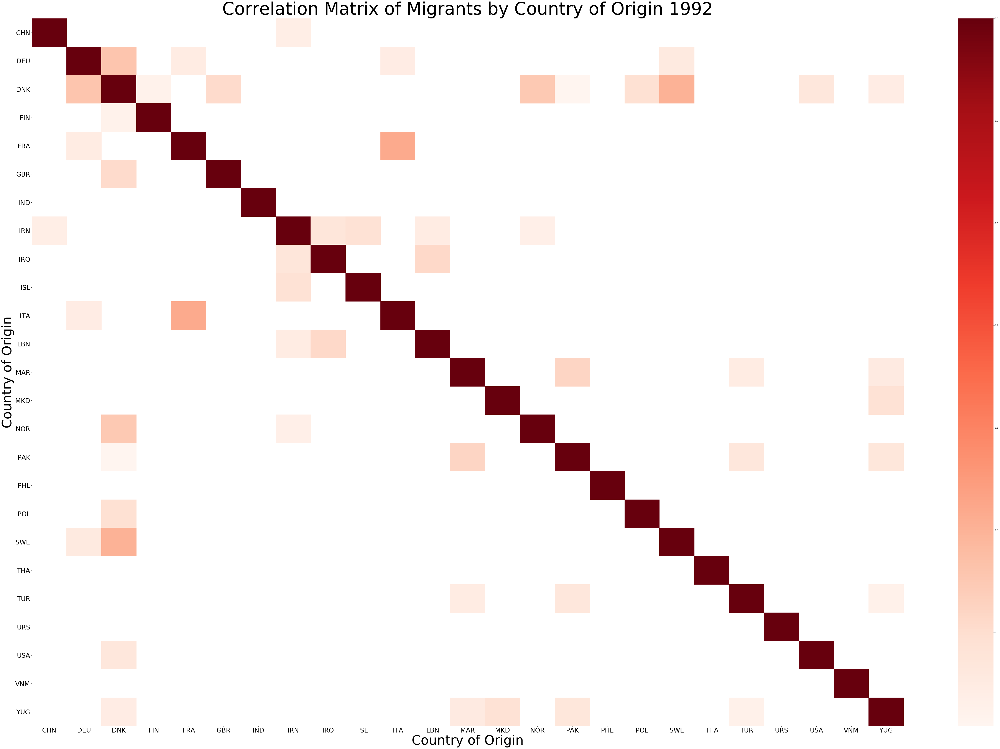

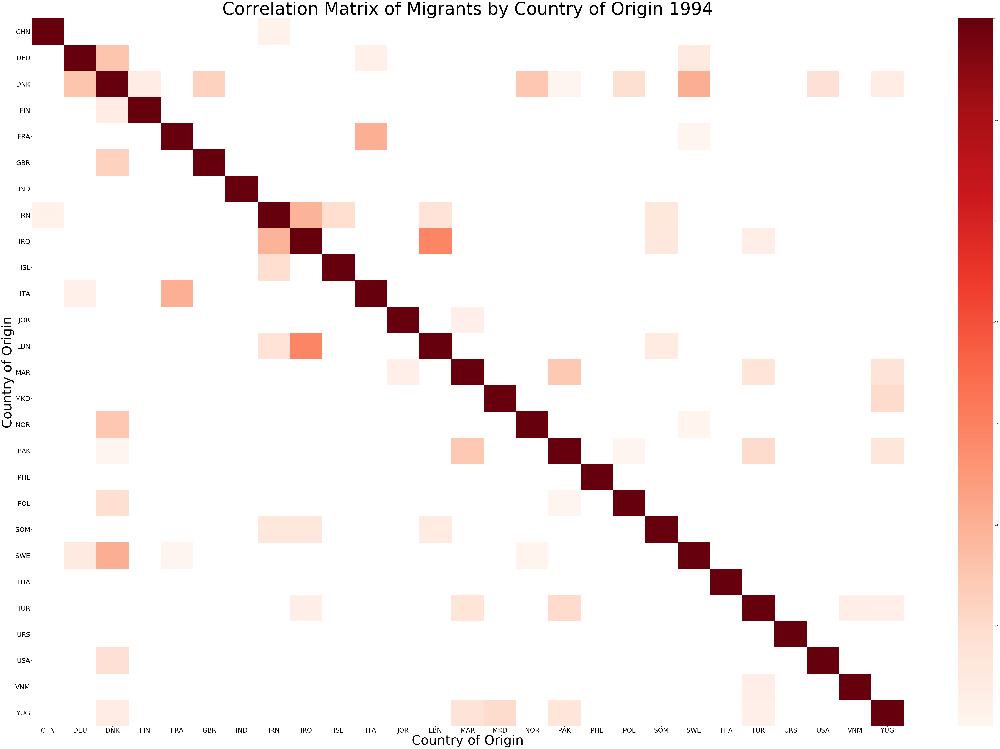

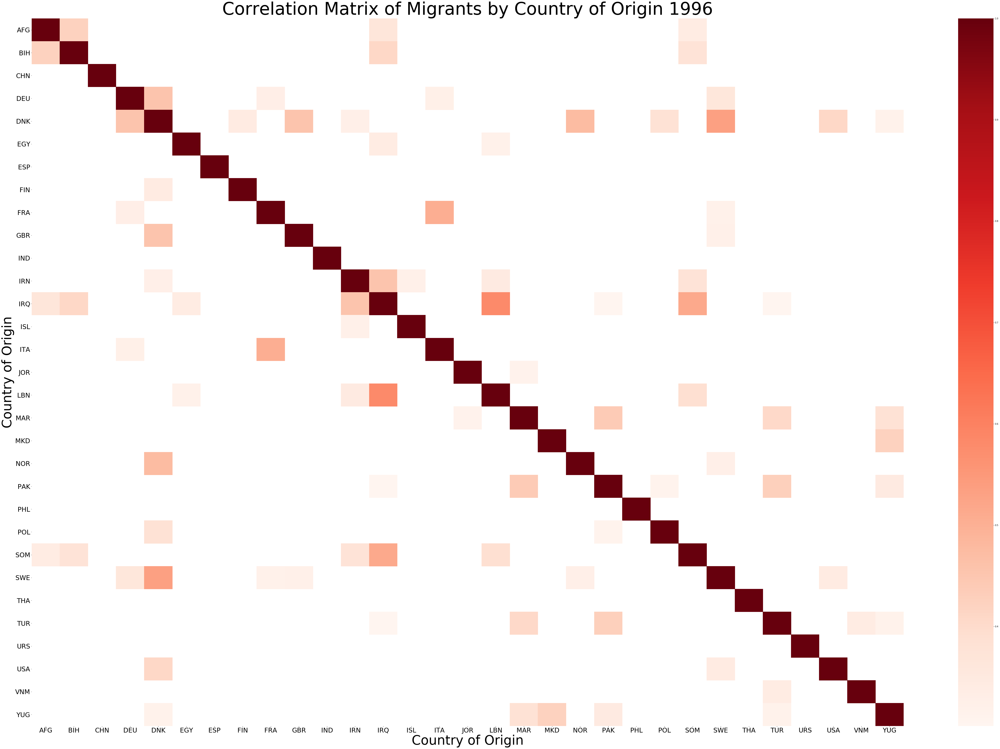

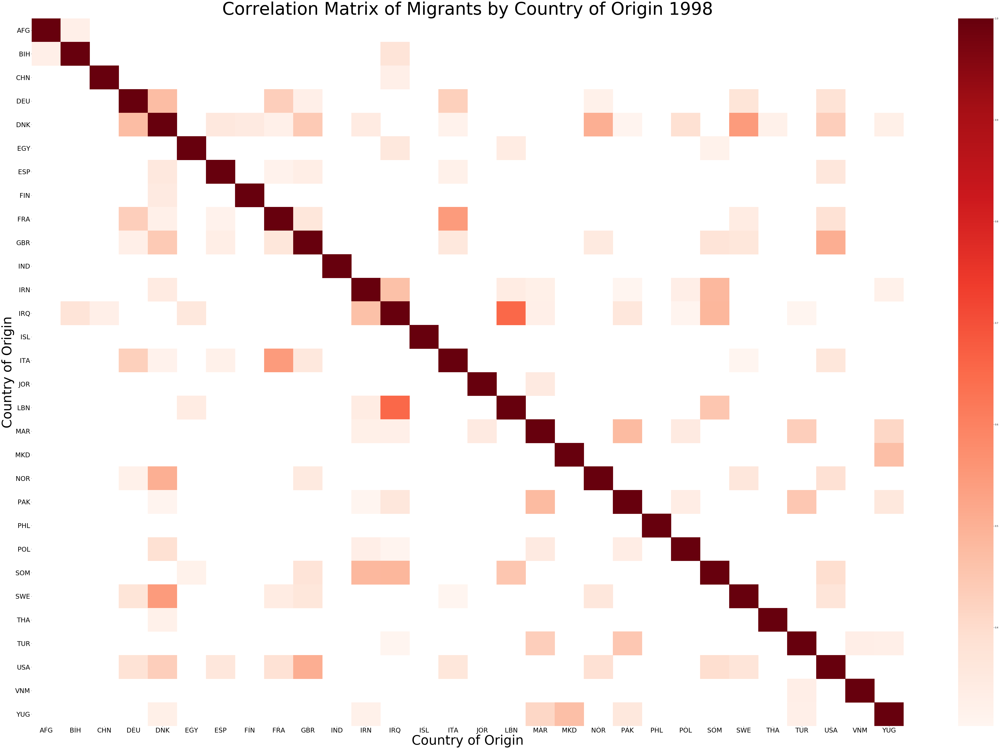

...

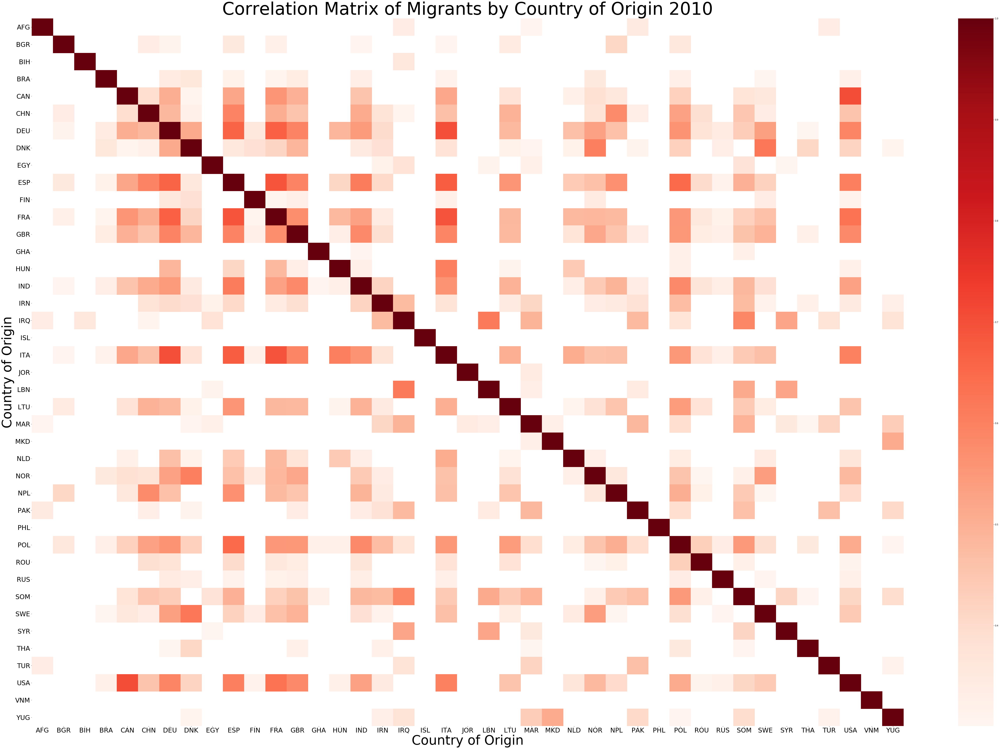

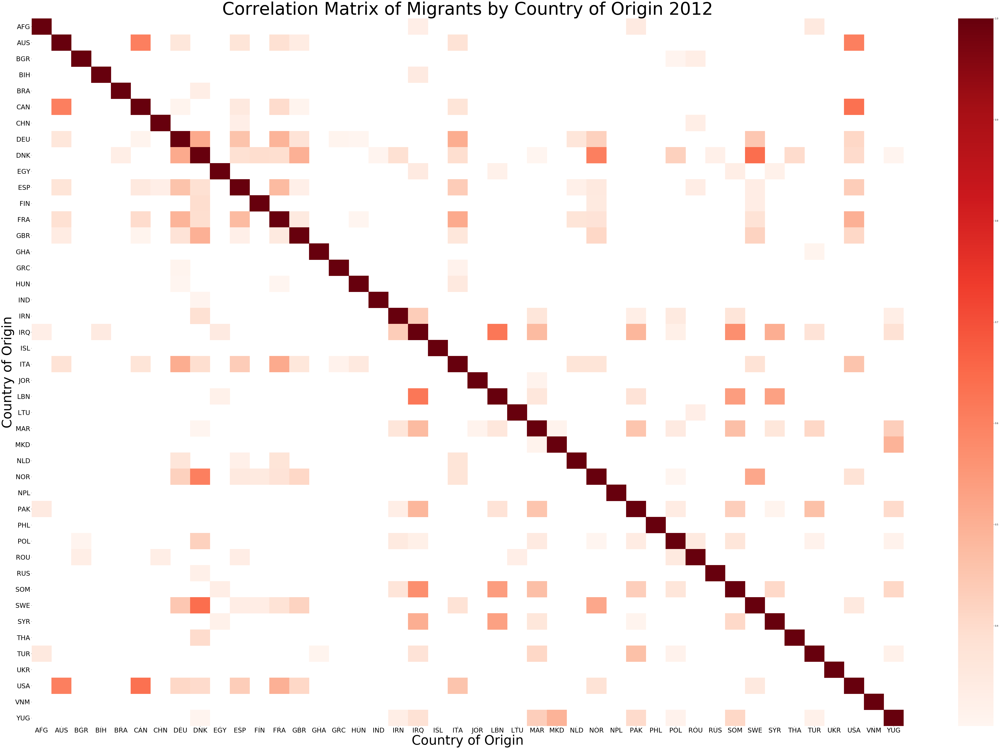

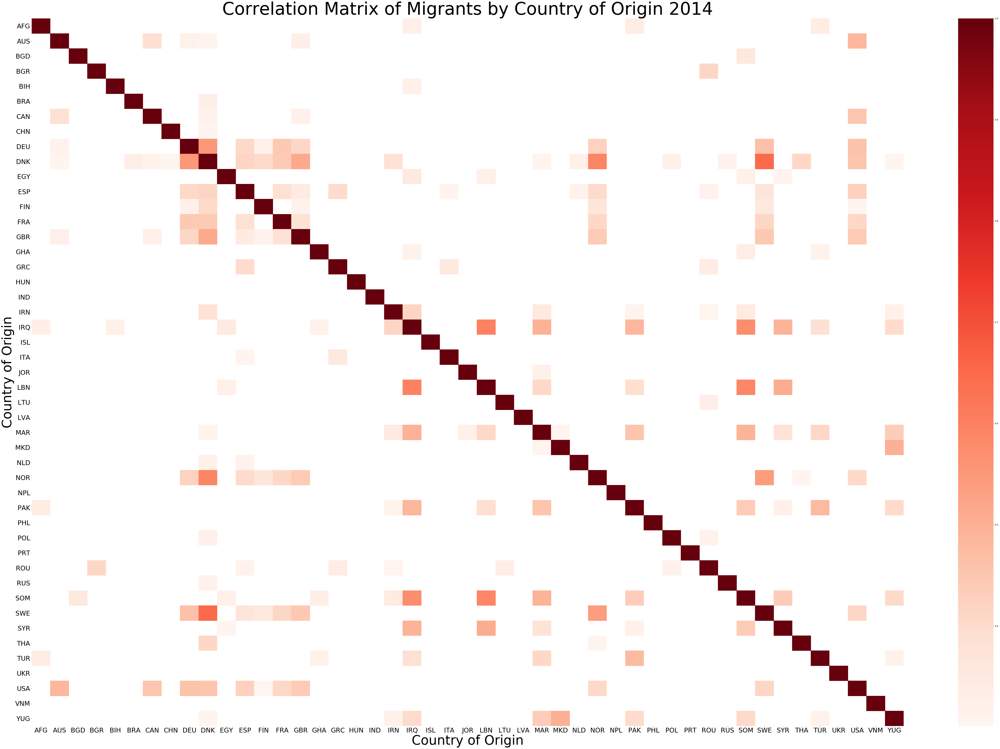

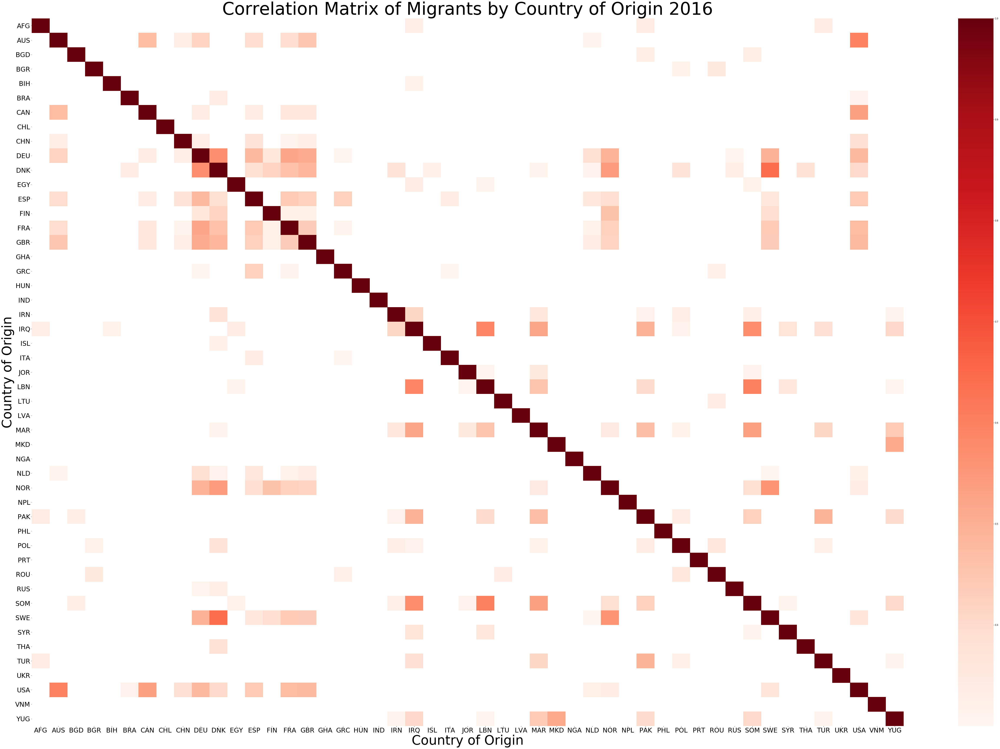

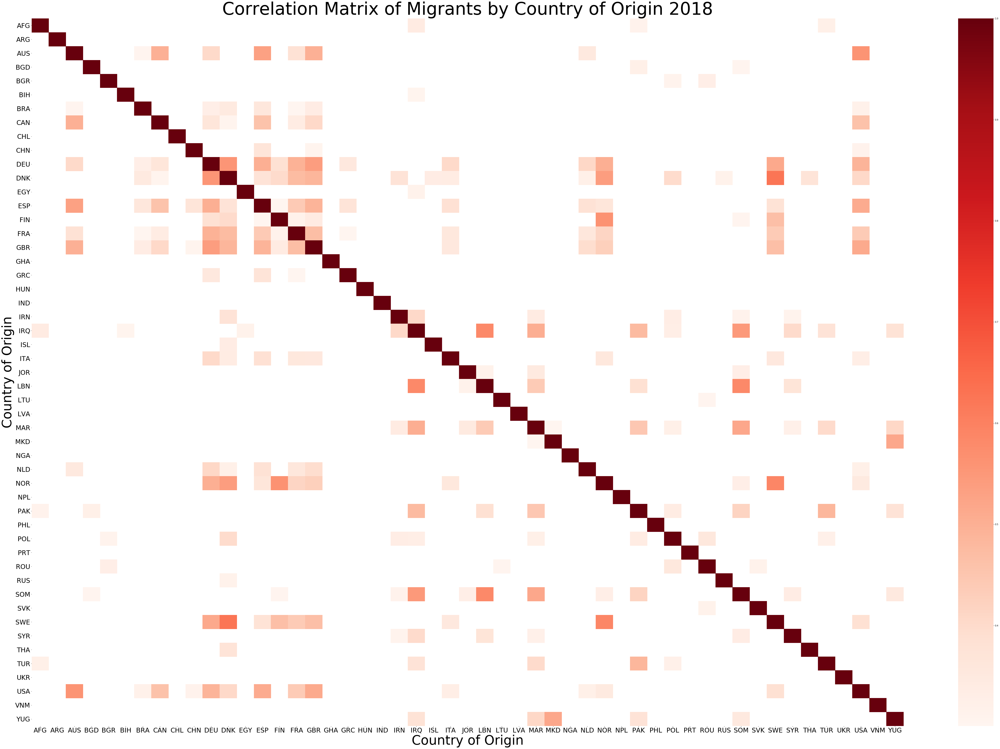

In [8]:
def calc_cor_sel(ancillary_POPdata_folder_path, year):
    
    # Load point data
    js = gpd.read_file(ancillary_POPdata_folder_path + '/{}/temp_shp/L10_PopCOO.shp'.format(year))
    js= js.iloc[:, :-3]
    lst =js.columns.tolist()
    dataframe_list=[]
    for i in lst:
        if i!='GC100m' :
            pop = js['{}'.format(i)].sum()
            #print(pop)
            if pop < 1000 and i!='DNK':
                dataframe_list.append(i)
    
    for j in dataframe_list:
        js = js.drop(['{}'.format(j)], axis=1)
    
    correlation_mat = js.corr(method='pearson')
    kot = correlation_mat[correlation_mat>=.3]
    plt.figure(figsize=(90,60))
    sns.heatmap(kot, cmap="Reds")

    plt.title("Correlation Matrix of Migrants by Country of Origin {}".format(year),fontsize=80)
    plt.xlabel("Country of Origin", fontsize=60)
    plt.ylabel("Country of Origin", fontsize=60)
    plt.xticks(fontsize=30, rotation=0)
    plt.yticks(fontsize=30, rotation=0)
    plt.savefig(cor_path + "/{}_corMatrixLimited.png".format(year), dpi=300)
    plt.show()  
    correlation_mat.to_csv(cor_path + "/{}_corLimited.csv".format(year))
    dataframe_list.clear()

#year=2018    
for year in years:
    calc_cor_sel(ancillary_POPdata_folder_path,year)

#### Calculate top 3 stronger pairs   

In [4]:
def calc_top3(ancillary_POPdata_folder_path, year):
    
    # Load point data
    js = gpd.read_file(ancillary_POPdata_folder_path + '/{}/temp_shp/L10_PopCOO.shp'.format(year))
    js= js.iloc[:, :-3]
    dataframe_list=[js]
    # Now get the rest of the sociodemographic data
    for file in os.listdir(ancillary_POPdata_folder_path + '/{}/temp_shp'.format(year)):
        # L2-L6 : 5 age groups
        # L11 : Births, L12 : Deaths
        # L13a : Marriages,male 
        # L18 : High Education
        # L19 : Share Rich , L20 : Share Poor
        indicators = ['L2','L3','L4','L5','L6','L11','L12','L13a', 'L18','L19','L20' ]
        for i in indicators:
            if file.endswith('.shp') and file.startswith('{0}_'.format(i)) and not file.endswith('NEWINCOME.shp'):
                #print(file)
                ks = gpd.read_file(ancillary_POPdata_folder_path + '/{0}/temp_shp/{1}'.format(year, file))
                ks=ks.iloc[:,0: 2]
                dataframe_list.append(ks)
    
    df_merged = pd.concat(dataframe_list)
    #print(df_merged.columns)             
    corr = df_merged.corr(method='pearson')
    np.fill_diagonal(corr.values, np.nan)
    
    order_top3 = np.argsort(-corr.values, axis=1)[:, :3]
    
    result = pd.DataFrame(
        corr.columns[order_top3], 
        columns=['1st', '2nd', '3rd'],
        index=corr.index
    ) 
    
    for x in result.columns:
        result[x+"_Val"] = corr.lookup(corr.index, result[x])
    output = result[['1st', '1st_Val', '2nd', '2nd_Val', '3rd', '3rd_Val']]
    output = output.nlargest(15, '1st_Val')
    print(output)
    output.to_csv(cor_path + "/corTop3_{}.csv".format(year))
    

In [5]:
for year in years:
    calc_top3(ancillary_POPdata_folder_path, year) 

     1st   1st_Val  2nd   2nd_Val  3rd   3rd_Val
DNK  SWE  0.650339  NOR  0.592426  DEU  0.552892
SWE  DNK  0.650339  NOR  0.540953  DEU  0.462342
IRQ  LBN  0.597984  SOM  0.572940  MAR  0.496850
LBN  IRQ  0.597984  SOM  0.589914  SYR  0.507614
NOR  DNK  0.592426  SWE  0.540953  GBR  0.440139
SOM  LBN  0.589914  IRQ  0.572940  MAR  0.494552
DEU  DNK  0.552892  SWE  0.462342  USA  0.457167
HRV  ITA  0.546694  GRC  0.219380  BIH  0.215084
ITA  HRV  0.546694  GRC  0.352277  ESP  0.306348
GBR  DNK  0.515217  SWE  0.445087  NOR  0.440139
SYR  LBN  0.507614  IRQ  0.492318  SOM  0.437108
MKD  YUG  0.499968  MAR  0.307499  PAK  0.294090
YUG  MKD  0.499968  MAR  0.433285  SOM  0.402775
MAR  IRQ  0.496850  SOM  0.494552  PAK  0.453636
PAK  IRQ  0.486826  TUR  0.477135  MAR  0.453636
     1st   1st_Val  2nd   2nd_Val  3rd   3rd_Val
DNK  SWE  0.642955  DEU  0.569065  NOR  0.543157
SWE  DNK  0.642955  NOR  0.559915  DEU  0.496373
LBN  SOM  0.598637  IRQ  0.591502  MAR  0.453727
SOM  LBN  0.598637  

## Read the data in Geopandas. Not applicable

In [ ]:
js_path= "K:/FUME/popnet/PoPNetV2/data_scripts/cph_Projectdata/PopData/1990/temp_shp/"
# Load point data
js = gpd.read_file(js_path+'L10_PopCOO.shp')
js1 = gpd.read_file(js_path+'L13a_Marriages_Male.shp')
df  = js.merge(js1.iloc[:,0: 2], on='GC100m', how='left')

In [ ]:
df.head()

In [ ]:
w = libpysal.weights.Queen.from_dataframe(js)
w.transform = "R"

In [ ]:
columns= js.columns[js.columns != 'GC100m'].tolist()
columns

## Correlation among countries of origin

In [ ]:
for i in columns:
    for j in columns:
        cor = js.corr().loc['{}'.format(i),'{}'.format(j)]
        if cor > 0  :
            print(i, j, cor )

In [ ]:
print(js.corr().loc['AFG','DNK'])

In [ ]:
import libpysal
import esda

weights = libpysal.weights.Queen.from_dataframe(js)  # generate spatial weights (Queen in this case)
spatial_auto = esda.Moran(js[['DNK']], weights)  # calculate Moran's I

In [ ]:
spatial_auto.I

In [ ]:
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster
fig, ax = moran_scatterplot(spatial_auto, aspect_equal=True)
plt.show()

#Local Spatial Autocorrelation

In [ ]:
import pysal
from esda.moran import Moran, Moran_Local
# calculate Moran Local 
m_local = Moran_Local(js['DNK'], w)